In [7]:
import pandas as pd
import numpy as np 

In [8]:
data = pd.read_csv(r"C:\ols-regression-challenge\nrippner-ols-regression-challenge\data\cancer_reg.csv")
data.head()

,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,binnedinc,medianage,...,pctprivatecoveragealone,pctempprivcoverage,pctpubliccoverage,pctpubliccoveragealone,pctwhite,pctblack,pctasian,pctotherrace,pctmarriedhouseholds,birthrate
0,1397.0,469,164.9,489.8,61898,260131,11.2,499.748204,"(61494.5, 125635]",39.3,...,NaN,41.6,32.9,14.0,81.780529,2.594728,4.821857,1.843479,52.856076,6.118831
1,173.0,70,161.3,411.6,48127,43269,18.6,23.111234,"(48021.6, 51046.4]",33.0,...,53.8,43.6,31.1,15.3,89.228509,0.969102,2.246233,3.741352,45.372500,4.333096
2,102.0,50,174.7,349.7,49348,21026,14.6,47.560164,"(48021.6, 51046.4]",45.0,...,43.5,34.9,42.1,21.1,90.922190,0.739673,0.465898,2.747358,54.444868,3.729488
3,427.0,202,194.8,430.4,44243,75882,17.1,342.637253,"(42724.4, 45201]",42.8,...,40.3,35.0,45.3,25.0,91.744686,0.782626,1.161359,1.362643,51.021514,4.603841
4,57.0,26,144.4,350.1,49955,10321,12.5,0.000000,"(48021.6, 51046.4]",48.3,...,43.9,35.1,44.0,22.7,94.104024,0.270192,0.665830,0.492135,54.027460,6.796657


In [9]:
data.info()
data.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3047 entries, 0 to 3046
Data columns (total 34 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   avganncount              3047 non-null   float64
 1   avgdeathsperyear         3047 non-null   int64  
 2   target_deathrate         3047 non-null   float64
 3   incidencerate            3047 non-null   float64
 4   medincome                3047 non-null   int64  
 5   popest2015               3047 non-null   int64  
 6   povertypercent           3047 non-null   float64
 7   studypercap              3047 non-null   float64
 8   binnedinc                3047 non-null   object 
 9   medianage                3047 non-null   float64
 10  medianagemale            3047 non-null   float64
 11  medianagefemale          3047 non-null   float64
 12  geography                3047 non-null   object 
 13  avghouseholdsize         3047 non-null   float64
 14  percentmarried          

,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,medianage,medianagemale,...,pctprivatecoveragealone,pctempprivcoverage,pctpubliccoverage,pctpubliccoveragealone,pctwhite,pctblack,pctasian,pctotherrace,pctmarriedhouseholds,birthrate
count,3047.000000,3047.000000,3047.000000,3047.000000,3047.000000,3.047000e+03,3047.000000,3047.000000,3047.000000,3047.000000,...,2438.000000,3047.000000,3047.000000,3047.000000,3047.000000,3047.000000,3047.000000,3047.000000,3047.000000,3047.000000
mean,606.338544,185.965868,178.664063,448.268586,47063.281917,1.026374e+05,16.878175,155.399415,45.272333,39.570725,...,48.453774,41.196324,36.252642,19.240072,83.645286,9.107978,1.253965,1.983523,51.243872,5.640306
std,1416.356223,504.134286,27.751511,54.560733,12040.090836,3.290592e+05,6.409087,529.628366,45.304480,5.226017,...,10.083006,9.447687,7.841741,6.113041,16.380025,14.534538,2.610276,3.517710,6.572814,1.985816
min,6.000000,3.000000,59.700000,201.300000,22640.000000,8.270000e+02,3.200000,0.000000,22.300000,22.400000,...,15.700000,13.500000,11.200000,2.600000,10.199155,0.000000,0.000000,0.000000,22.992490,0.000000
25%,76.000000,28.000000,161.200000,420.300000,38882.500000,1.168400e+04,12.150000,0.000000,37.700000,36.350000,...,41.000000,34.500000,30.900000,14.850000,77.296180,0.620675,0.254199,0.295172,47.763063,4.521419
50%,171.000000,61.000000,178.100000,453.549422,45207.000000,2.664300e+04,15.900000,0.000000,41.000000,39.600000,...,48.700000,41.100000,36.300000,18.800000,90.059774,2.247576,0.549812,0.826185,51.669941,5.381478
75%,518.000000,149.000000,195.200000,480.850000,52492.000000,6.867100e+04,20.400000,83.650776,44.000000,42.500000,...,55.600000,47.700000,41.550000,23.100000,95.451693,10.509732,1.221037,2.177960,55.395132,6.493677
max,38150.000000,14010.000000,362.800000,1206.900000,125635.000000,1.017029e+07,47.400000,9762.308998,624.000000,64.700000,...,78.900000,70.700000,65.100000,46.600000,100.000000,85.947799,42.619425,41.930251,78.075397,21.326165


In [10]:
null_values = data.isnull().sum()
print(null_values[null_values>0])
print(null_values)


pctsomecol18_24            2285
pctemployed16_over          152
pctprivatecoveragealone     609
dtype: int64
avganncount                   0
avgdeathsperyear              0
target_deathrate              0
incidencerate                 0
medincome                     0
popest2015                    0
povertypercent                0
studypercap                   0
binnedinc                     0
medianage                     0
medianagemale                 0
medianagefemale               0
geography                     0
avghouseholdsize              0
percentmarried                0
pctnohs18_24                  0
pcths18_24                    0
pctsomecol18_24            2285
pctbachdeg18_24               0
pcths25_over                  0
pctbachdeg25_over             0
pctemployed16_over          152
pctunemployed16_over          0
pctprivatecoverage            0
pctprivatecoveragealone     609
pctempprivcoverage            0
pctpubliccoverage             0
pctpubliccoveragealone     

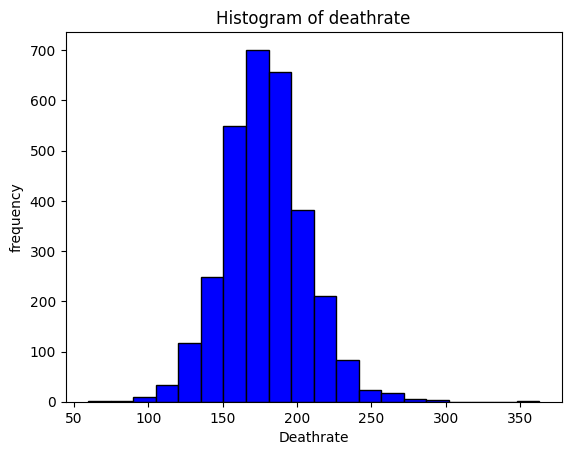

In [11]:
import matplotlib.pyplot as plt


plt.hist(data["target_deathrate"], bins = 20, color = 'blue', edgecolor = 'black')
plt.xlabel('Deathrate')
plt.ylabel('frequency')
plt.title('Histogram of deathrate')
plt.show()

In [12]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Box(y=data['target_deathrate'], boxpoints='outliers', jitter=0.3, pointpos=-1.8)])

fig.update_layout(
    title='Boxplot of DeathRate',
    yaxis_title='DeathRate',
    width=700,
    height=500)
fig.show()


Mean of avgAnnCount: 606.3385437820807
Standard deviation of AvgAnnCount: 1416.3562232267052


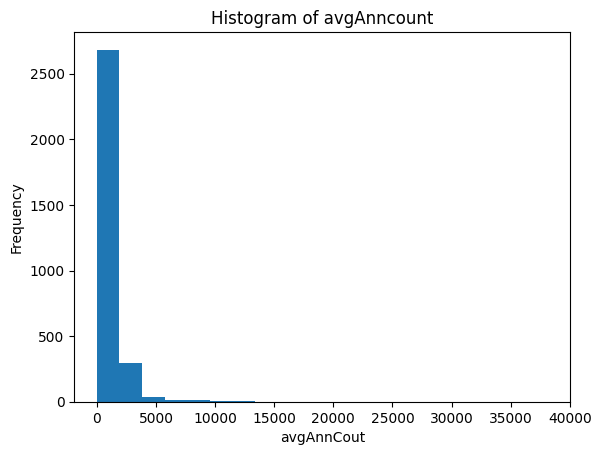

correlation between avgAnn Count and TARGET_deathrate: -0.14353161968868813


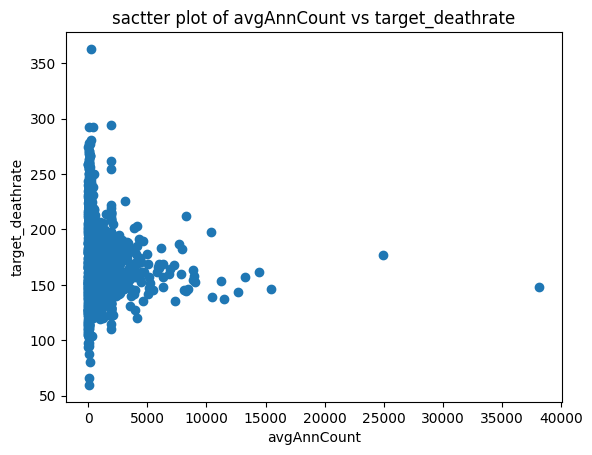

In [13]:
avg_ann_count_mean = data["avganncount"].mean()
avg_ann_count_std= data["avganncount"].std()
print("Mean of avgAnnCount:",avg_ann_count_mean)
print("Standard deviation of AvgAnnCount:",avg_ann_count_std)

plt.hist(data["avganncount"],bins=20)
plt.xlabel("avgAnnCout")
plt.ylabel("Frequency")
plt.title("Histogram of avgAnncount")
plt.show()

fig = go.Figure(data=[go.Box(y=data['avganncount'],boxpoints='outliers',jitter=0.3 , pointpos=-1.8)])
fig.update_layout(
    title='Boxplot of Avganncount',
    yaxis_title='Death Rate',
    width=700,
    height=500)
fig.show()

corr = data["avganncount"].corr(data["target_deathrate"])
print("correlation between avgAnn Count and TARGET_deathrate:",corr)

plt.scatter(data["avganncount"], data["target_deathrate"])
plt.xlabel("avgAnnCount")
plt.ylabel("target_deathrate")
plt.title("sactter plot of avgAnnCount vs target_deathrate")
plt.show()

In [14]:
missing_values = data.isnull().sum()
print(missing_values[missing_values > 0])

pctsomecol18_24            2285
pctemployed16_over          152
pctprivatecoveragealone     609
dtype: int64


In [15]:
processed_data = pd.read_csv(r"C:\ols-regression-challenge\preprocessed_data.csv")
processed_data.head()


,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,medianage,medianagemale,...,state_ South Dakota,state_ Tennessee,state_ Texas,state_ Utah,state_ Vermont,state_ Virginia,state_ Washington,state_ West Virginia,state_ Wisconsin,state_ Wyoming
0,1397.0,469,164.9,489.8,61898,260131,11.2,499.748204,39.3,36.9,...,0,0,0,0,0,0,1,0,0,0
1,173.0,70,161.3,411.6,48127,43269,18.6,23.111234,33.0,32.2,...,0,0,0,0,0,0,1,0,0,0
2,102.0,50,174.7,349.7,49348,21026,14.6,47.560164,45.0,44.0,...,0,0,0,0,0,0,1,0,0,0
3,427.0,202,194.8,430.4,44243,75882,17.1,342.637253,42.8,42.2,...,0,0,0,0,0,0,1,0,0,0
4,57.0,26,144.4,350.1,49955,10321,12.5,0.000000,48.3,47.8,...,0,0,0,0,0,0,1,0,0,0


In [16]:
import numpy as np
from scipy.stats import normaltest

numerical_columns = processed_data.select_dtypes(include=np.number).columns

gaussian_cols = []
non_gaussian_cols = []

for col in numerical_columns:
    print(f"Processing column: {col}")  # Debugging step
    if col in processed_data.columns:  # Extra check
        stat, p = normaltest(processed_data[col])
        print(f"Statistic={stat:.3f}, p={p:.3f}")
        
        alpha = 0.05
        if p > alpha:
            gaussian_cols.append(col)
        else:
            non_gaussian_cols.append(col)
    else:
        print(f"Column {col} not found!")

print("Gaussian columns:", gaussian_cols)
print("Non-Gaussian columns:", non_gaussian_cols)


Processing column: avganncount
Statistic=5028.465, p=0.000
Processing column: avgdeathsperyear
Statistic=5314.434, p=0.000
Processing column: target_deathrate
Statistic=127.363, p=0.000
Processing column: incidencerate
Statistic=943.641, p=0.000
Processing column: medincome
Statistic=854.431, p=0.000
Processing column: popest2015
Statistic=5801.694, p=0.000
Processing column: povertypercent
Statistic=408.566, p=0.000
Processing column: studypercap
Statistic=4449.679, p=0.000
Processing column: medianage
Statistic=4715.992, p=0.000
Processing column: medianagemale
Statistic=42.880, p=0.000
Processing column: medianagefemale
Statistic=48.305, p=0.000
Processing column: avghouseholdsize
Statistic=2293.395, p=0.000
Processing column: percentmarried
Statistic=236.299, p=0.000
Processing column: pctnohs18_24
Statistic=508.655, p=0.000
Processing column: pcths18_24
Statistic=39.668, p=0.000
Processing column: pctbachdeg18_24
Statistic=1395.030, p=0.000
Processing column: pcths25_over
Statisti

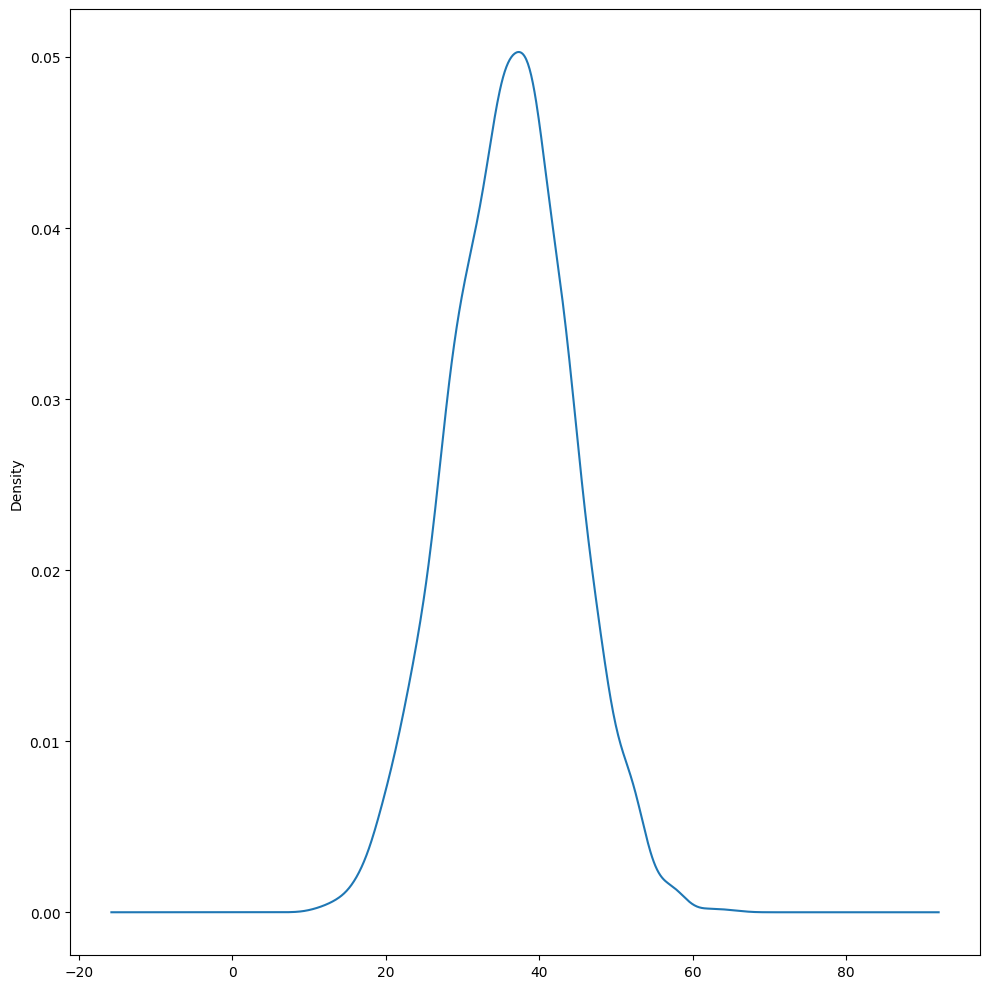

In [17]:
fig, ax = plt.subplots(figsize=(10,10))  # Single axis
for col in gaussian_cols:
    processed_data[col].plot(kind='kde', ax=ax)
plt.tight_layout()
plt.show()


In [18]:
gaussian_data = processed_data[gaussian_cols]
basic_info_gaussian = gaussian_data.describe()

In [19]:
gaussian_data

,pctpubliccoverage
0,32.9
1,31.1
2,42.1
3,45.3
4,44.0
...,...
3042,31.7
3043,28.8
3044,26.6
3045,29.5


In [20]:
basic_info_gaussian = basic_info_gaussian.loc[['mean','std','min','max']]
basic_info_gaussian

,pctpubliccoverage
mean,36.252642
std,7.841741
min,11.200000
max,65.100000


In [21]:
print("Highest allowed",basic_info_gaussian['pctpubliccoverage']['mean'] +3*basic_info_gaussian['pctpubliccoverage']['std'])
print("Lowest allowed",basic_info_gaussian['pctpubliccoverage']['mean'] -3*basic_info_gaussian['pctpubliccoverage']['std'])

processed_data[(processed_data['pctpubliccoverage'] > 59.777864755203105) |(processed_data['pctpubliccoverage'] < 12.727419130586192)]

Highest allowed 59.777864755203105
Lowest allowed 12.727419130586192


,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,medianage,medianagemale,...,state_ South Dakota,state_ Tennessee,state_ Texas,state_ Utah,state_ Vermont,state_ Virginia,state_ Washington,state_ West Virginia,state_ Wisconsin,state_ Wyoming
176,25.0,10,134.3,359.0,27627,4596,24.2,0.000000,42.6,44.0,...,0,0,0,0,0,0,0,0,0,0
209,862.0,283,136.5,364.9,122641,375629,3.9,449.912014,35.3,34.9,...,0,0,0,0,0,1,0,0,0,0
1486,1067.0,358,142.9,444.5,51907,118891,10.9,84.110656,65.3,64.7,...,0,0,0,0,0,0,0,0,0,0
2713,8.0,3,203.3,201.3,68387,5702,9.9,0.000000,36.8,38.8,...,0,0,0,0,0,0,0,0,0,0
2740,129.0,54,126.1,332.0,32533,20152,22.8,0.000000,54.8,54.8,...,0,0,0,0,0,0,0,0,0,0


In [22]:
def deal_with_outliers(df,col,basic_info):
    highest_allowed = basic_info[col]["mean"] +3*basic_info[col]["std"]
    lowest_allowed = basic_info[col]["mean"] -3*basic_info[col]["std"]
    df = df [(df[col] > highest_allowed) | (df[col] < lowest_allowed )]
    return df
cols_have_outliers = []
for col in gaussian_cols:
    df = deal_with_outliers(gaussian_data,col,basic_info_gaussian)
    shape = df.shape 
    if shape[0] > 0:
        cols_have_outliers.append(col)
print(cols_have_outliers)     
df   

['pctpubliccoverage']


,pctpubliccoverage
176,62.7
209,11.8
1486,65.1
2713,11.2
2740,62.2


In [23]:
for col in cols_have_outliers:
    highest_allowed = basic_info_gaussian[col]["mean"] + 3*basic_info_gaussian[col]['std']
    lowest_allowed = basic_info_gaussian[col]["mean"] - 3*basic_info_gaussian[col]['std']
    trimmed_data = processed_data[(processed_data[col] < highest_allowed) &(processed_data[col] >lowest_allowed)]
trimmed_data    

,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,medianage,medianagemale,...,state_ South Dakota,state_ Tennessee,state_ Texas,state_ Utah,state_ Vermont,state_ Virginia,state_ Washington,state_ West Virginia,state_ Wisconsin,state_ Wyoming
0,1397.000000,469,164.9,489.800000,61898,260131,11.2,499.748204,39.3,36.9,...,0,0,0,0,0,0,1,0,0,0
1,173.000000,70,161.3,411.600000,48127,43269,18.6,23.111234,33.0,32.2,...,0,0,0,0,0,0,1,0,0,0
2,102.000000,50,174.7,349.700000,49348,21026,14.6,47.560164,45.0,44.0,...,0,0,0,0,0,0,1,0,0,0
3,427.000000,202,194.8,430.400000,44243,75882,17.1,342.637253,42.8,42.2,...,0,0,0,0,0,0,1,0,0,0
4,57.000000,26,144.4,350.100000,49955,10321,12.5,0.000000,48.3,47.8,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3042,1962.667684,15,149.6,453.549422,46961,6343,12.4,0.000000,44.2,41.1,...,0,0,0,0,0,0,0,0,0,0
3043,1962.667684,43,150.1,453.549422,48609,37118,18.8,377.175494,30.4,29.3,...,0,0,0,0,0,0,0,0,0,0
3044,1962.667684,46,153.9,453.549422,51144,34536,15.0,1968.959926,30.9,30.5,...,0,0,0,0,0,0,0,0,0,0
3045,1962.667684,52,175.0,453.549422,50745,25609,13.3,0.000000,39.0,36.9,...,0,0,0,0,0,0,0,0,0,0


In [24]:
import pandas as pd

# Load the dataset (ensure the correct file path)
processed_data = pd.read_csv("preprocessed_data.csv")

# Compute mean and standard deviation for numeric columns
basic_info_gaussian = processed_data.describe().T[['mean', 'std']]

# Identify columns with outliers (assuming they are numeric columns)
cols_have_outliers = basic_info_gaussian.index.tolist()

# Create a copy of the processed data
capped_data = processed_data.copy()

# Loop through each column to apply outlier capping
for col in cols_have_outliers:
    highest_allowed = basic_info_gaussian.loc[col, "mean"] + 3 * basic_info_gaussian.loc[col, "std"]
    lowest_allowed = basic_info_gaussian.loc[col, "mean"] - 3 * basic_info_gaussian.loc[col, "std"]

    # Cap values beyond the threshold
    capped_data[col] = capped_data[col].clip(lower=lowest_allowed, upper=highest_allowed)

# Display the modified dataset
print(capped_data)


      avganncount  avgdeathsperyear  target_deathrate  incidencerate  \
0     1397.000000             469.0             164.9     489.800000   
1      173.000000              70.0             161.3     411.600000   
2      102.000000              50.0             174.7     349.700000   
3      427.000000             202.0             194.8     430.400000   
4       57.000000              26.0             144.4     350.100000   
...           ...               ...               ...            ...   
3042  1962.667684              15.0             149.6     453.549422   
3043  1962.667684              43.0             150.1     453.549422   
3044  1962.667684              46.0             153.9     453.549422   
3045  1962.667684              52.0             175.0     453.549422   
3046  1962.667684              48.0             213.6     453.549422   

      medincome  popest2015  povertypercent  studypercap  medianage  \
0       61898.0    260131.0            11.2   499.748204       3

In [25]:
import pandas as pd
processed_data = pd.read_csv("preprocessed_data.csv")
cols_to_remove = []
for col in processed_data.columns:
    if processed_data[col].nunique() < 10:
        cols_to_remove.append(col)
print(len(cols_to_remove))        
data_for_skewness = processed_data.drop(cols_to_remove, axis=1)

1870


In [26]:
def identify_skewed_cols(df, cols):
    skewed_cols = []
    for col in cols:
        skew = df[col].skew()
        print(f"Column: {col}, Skewness: {skew}")  # Debugging
        if skew > 1 or skew < -1:
            skewed_cols.append(col)
    print(f"Total Skewed Columns Found: {len(skewed_cols)}")  # Debugging
    return skewed_cols

skewed_cols = identify_skewed_cols(data_for_skewness, data_for_skewness.columns)
print(len(skewed_cols))


Column: avganncount, Skewness: 10.680460336510137
Column: avgdeathsperyear, Skewness: 11.949187831315413
Column: target_deathrate, Skewness: 0.27472416526154386
Column: incidencerate, Skewness: 0.7719347387973914
Column: medincome, Skewness: 1.408070730129756
Column: popest2015, Skewness: 14.289926352518503
Column: povertypercent, Skewness: 0.930712509461498
Column: studypercap, Skewness: 8.713689816797178
Column: medianage, Skewness: 9.989944180239183
Column: medianagemale, Skewness: 0.13204093260050728
Column: medianagefemale, Skewness: -0.20838386540505244
Column: avghouseholdsize, Skewness: -3.380987850618506
Column: percentmarried, Skewness: -0.6534872117669566
Column: pctnohs18_24, Skewness: 0.9733451898743336
Column: pcths18_24, Skewness: 0.17920909672420798
Column: pctbachdeg18_24, Skewness: 1.9562007174027167
Column: pcths25_over, Skewness: -0.3336349447968398
Column: pctbachdeg25_over, Skewness: 1.094837086249807
Column: pctemployed16_over, Skewness: -0.3976848916813583
Colum

In [27]:
skewed_data = data_for_skewness[skewed_cols]

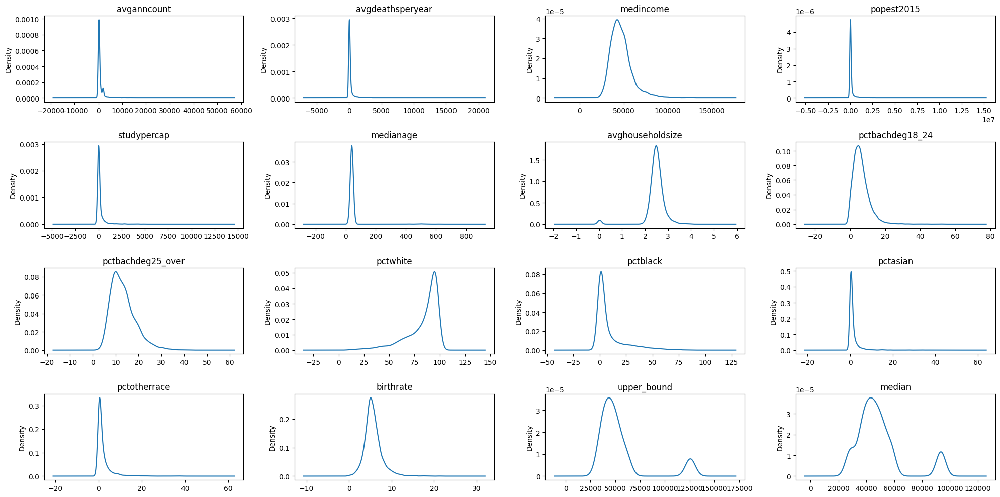

In [28]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 10))  # Creating 4x4 subplots

for i, col in enumerate(skewed_cols):
    row = i // 4  # Determine row index
    col_idx = i % 4  # Determine column index
    axes[row, col_idx].set_title(col)  # Set title for each subplot

    # Plot density plot
    skewed_data[col].plot(kind='density', ax=axes[row, col_idx])

plt.tight_layout()  # Adjust layout to prevent overlapping
plt.show()  # Display the plots


In [29]:
def box_plot(df, col):
    fig = go.Figure(data=[go.Box(y=df[col],boxpoints='outliers',jitter=0.3,pointpos=1.8)])
    fig.update_layout(
        title='boxplot of' + col,
        yaxis_title=col,
        width=500,
        height=500)
    fig.show()

for col in skewed_cols:
    box_plot(processed_data, col)    

In [30]:
percentile25 = processed_data['studypercap'].quantile(0.25)
percentile75 = processed_data['studypercap'].quantile(0.75)

iqr = percentile75 - percentile25
upper_limit = percentile75 + 1.5 *iqr
lower_limit = percentile25 - 1.5 *iqr
print("upper limit",upper_limit)
print("lower limit",lower_limit)

processed_data[(processed_data['studypercap'] > upper_limit) | (processed_data['studypercap'] < lower_limit)]

upper limit 209.1269406875
lower limit -125.4761644125


,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,medianage,medianagemale,...,state_ South Dakota,state_ Tennessee,state_ Texas,state_ Utah,state_ Vermont,state_ Virginia,state_ Washington,state_ West Virginia,state_ Wisconsin,state_ Wyoming
0,1397.000000,469,164.9,489.800000,61898,260131,11.2,499.748204,39.3,36.9,...,0,0,0,0,0,0,1,0,0,0
3,427.000000,202,194.8,430.400000,44243,75882,17.1,342.637253,42.8,42.2,...,0,0,0,0,0,0,1,0,0,0
9,4025.000000,1380,177.8,510.900000,60397,843954,13.1,427.748432,35.8,34.7,...,0,0,0,0,0,0,1,0,0,0
11,740.000000,269,172.7,499.300000,51395,121846,15.7,837.122269,41.0,40.0,...,0,0,0,0,0,0,1,0,0,0
14,2265.000000,901,171.0,440.700000,50083,490945,16.3,462.373586,37.2,35.7,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3038,1962.667684,138,153.7,453.549422,49246,118053,19.4,660.720185,28.8,28.0,...,0,0,0,0,0,0,0,0,0,0
3039,1962.667684,9,208.3,453.549422,49256,2968,10.5,673.854447,45.2,45.2,...,0,0,0,0,0,0,0,0,0,0
3041,1962.667684,48,146.4,453.549422,49508,29029,13.0,723.414516,32.2,31.0,...,0,0,0,0,0,0,0,0,0,0
3043,1962.667684,43,150.1,453.549422,48609,37118,18.8,377.175494,30.4,29.3,...,0,0,0,0,0,0,0,0,0,0


In [31]:
def deal_with_outliers_with_iqr(df, col):
    percentile25 = df[col].quantile(0.25)
    percentile75 = df[col].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr
    outliers = df[(df[col] > upper_limit) | (df[col] < lower_limit)]  # Changed 'outlier' to 'outliers'
    return outliers  # Ensure correct return variable


In [32]:
def deal_with_outliers_with_iqr(df, col):
    percentile25 = df[col].quantile(0.25)
    percentile75 = df[col].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr
    outliers = df[(df[col] > upper_limit) | (df[col] < lower_limit)]  # Correct variable name
    return outliers  # Ensure correct return variable


In [33]:
import pandas as pd
import numpy as np
processed_data = pd.read_csv("preprocessed_data.csv")
skewed_cols = processed_data.select_dtypes(include=[np.number]).columns[
    processed_data.skew() > 0.5  # You can adjust this threshold
].tolist()


In [34]:
cols_have_outliers_skewed = []
for col in skewed_cols:
    outliers = deal_with_outliers_with_iqr(processed_data, col)
    shape = outliers.shape
    if shape[0] > 0:
        cols_have_outliers_skewed.append(col)

print(cols_have_outliers_skewed)


['avganncount', 'avgdeathsperyear', 'incidencerate', 'medincome', 'popest2015', 'povertypercent', 'studypercap', 'medianage', 'pctnohs18_24', 'pctbachdeg18_24', 'pctbachdeg25_over', 'pctunemployed16_over', 'pctblack', 'pctasian', 'pctotherrace', 'birthrate', 'upper_bound', 'median', 'country_Abbeville County', 'country_Acadia Parish', 'country_Accomack County', 'country_Ada County', 'country_Adair County', 'country_Adams County', 'country_Addison County', 'country_Aiken County', 'country_Aitkin County', 'country_Alachua County', 'country_Alamance County', 'country_Alameda County', 'country_Alamosa County', 'country_Albany County', 'country_Albemarle County', 'country_Alcona County', 'country_Alcorn County', 'country_Aleutians West Census Area', 'country_Alexander County', 'country_Alexandria city', 'country_Alfalfa County', 'country_Alger County', 'country_Allamakee County', 'country_Allegan County', 'country_Allegany County', 'country_Alleghany County', 'country_Allegheny County', 'co

In [35]:
def deal_with_iqr(df, col):
    percentile25 = df[col].quantile(0.25)
    percentile75 = df[col].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr
    outliers = df[(df[col] > upper_limit) | (df[col] < lower_limit)]  # Define `outliers` here
    return outliers


In [36]:
rows_to_remove = processed_data[(processed_data['studypercap'] > upper_limit) | (processed_data['studypercap'] < lower_limit)]
trimmed_data = processed_data[(processed_data['studypercap'] < upper_limit) & (processed_data['studypercap'] > lower_limit)]
trimmed_data.shape

(2543, 1904)

In [37]:
capped_data = processed_data.copy()
capped_data.loc[capped_data['studypercap'] > upper_limit, 'studypercap'] = upper_limit
capped_data.loc[capped_data['studypercap'] < lower_limit, 'studypercap'] = lower_limit
capped_data.shape

(3047, 1904)

In [40]:
# Ensure the variable is defined
if 'cols_have_outliers_skewed' not in globals():
    cols_have_outliers_skewed = []

# Define the capping function
def capping(df, col):
    percentile25 = df[col].quantile(0.25)
    percentile75 = df[col].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr
    df.loc[df[col] > upper_limit, col] = upper_limit
    df.loc[df[col] < lower_limit, col] = lower_limit
    return df

# Apply capping to columns with outliers
for col in cols_have_outliers_skewed:
    processed_data = capping(processed_data, col)

# Check shape after capping
print(processed_data.shape)


C:\Users\rubik\AppData\Local\Temp\ipykernel_12932\2843879875.py:12: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '330.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.

C:\Users\rubik\AppData\Local\Temp\ipykernel_12932\2843879875.py:12: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '72906.25' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.

C:\Users\rubik\AppData\Local\Temp\ipykernel_12932\2843879875.py:12: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '154151.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.



(3047, 1904)


In [45]:
def capping(df, col):
    percentile25 = df[col].quantile(0.25)
    percentile75 = df[col].quantile(0.75)
    iqr = percentile75 - percentile25
    upper_limit = percentile75 + 1.5 * iqr
    lower_limit = percentile25 - 1.5 * iqr
    df.loc[df[col] > upper_limit, col] = upper_limit
    df.loc[df[col] < lower_limit, col] = lower_limit
    return df  # Return the modified DataFrame

# Ensure cols_have_outliers_skewed is defined before using it
if 'cols_have_outliers_skewed' not in globals():
    cols_have_outliers_skewed = []

# Apply capping to all skewed columns
for col in cols_have_outliers_skewed:
    processed_data = capping(processed_data, col)

print(processed_data.shape)  # Check the shape of the processed data


(3047, 1904)


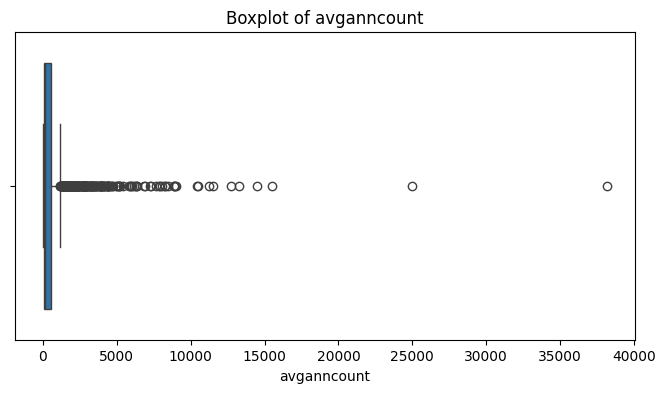

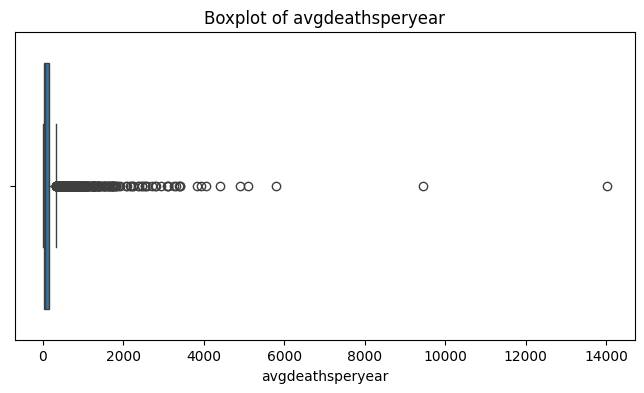

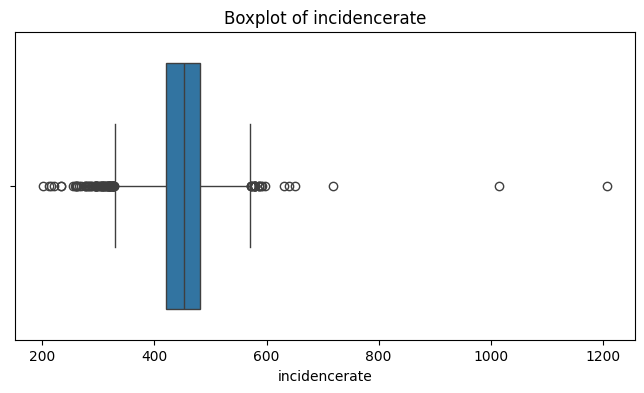

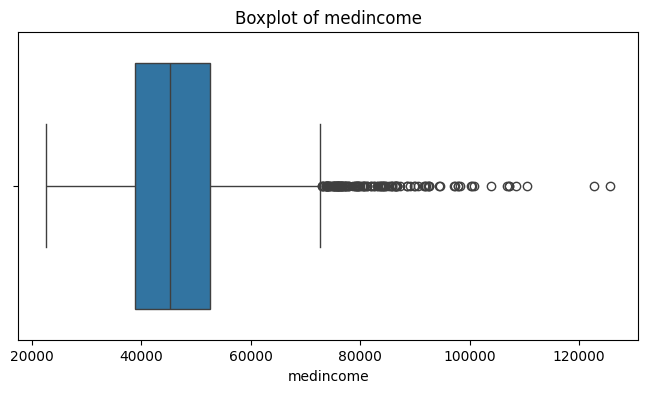

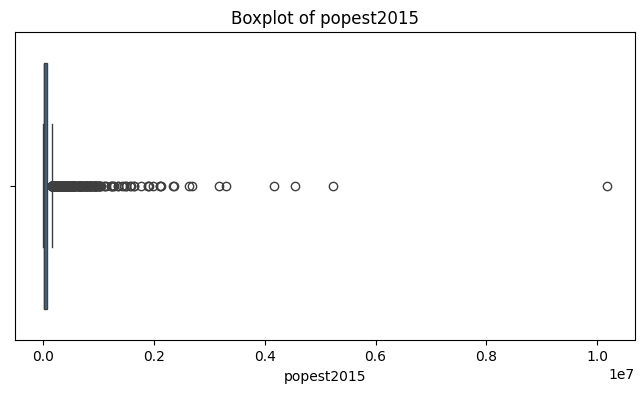

...

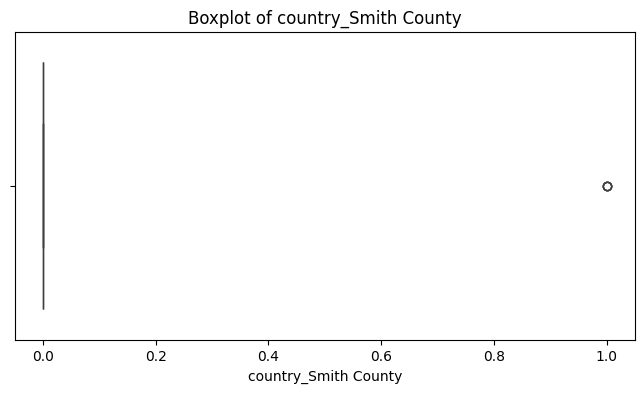

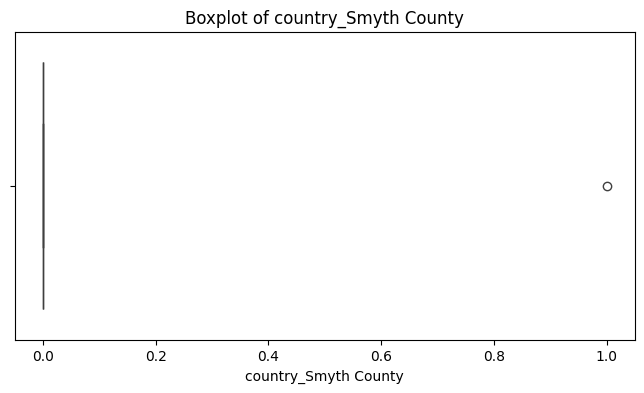

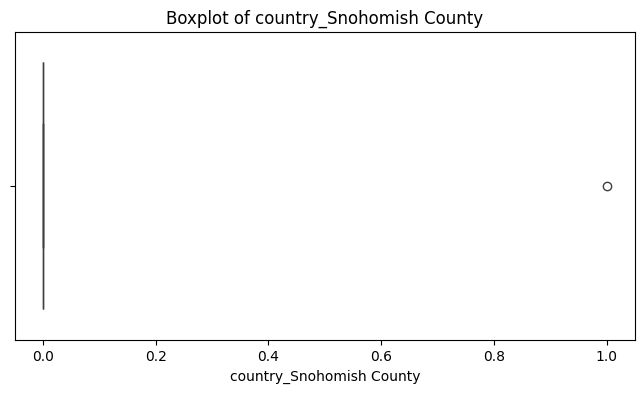

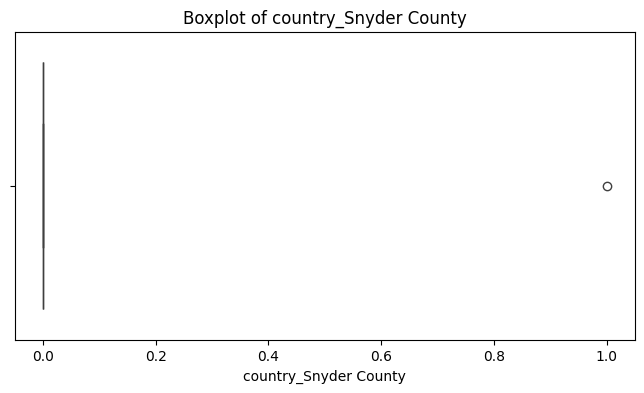

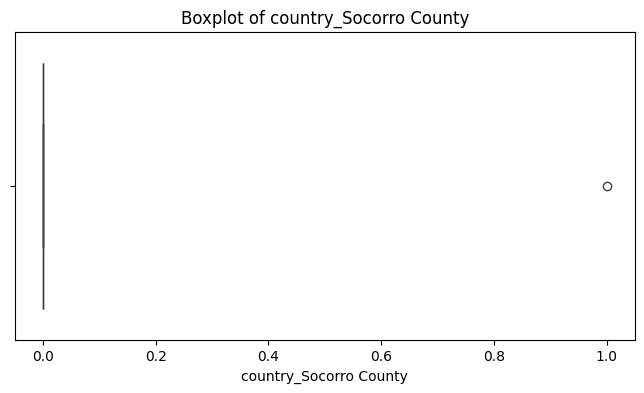

KeyboardInterrupt: 

In [46]:
for col in cols_have_outliers_skewed:
    box_plot(capped_data, col)

In [51]:
capped_data.to_csv(r"C:\ols-regression-challenge\capped_data.csv", index=False)

In [52]:
print(capped_data.columns)


Index(['avganncount', 'avgdeathsperyear', 'target_deathrate', 'incidencerate',
       'medincome', 'popest2015', 'povertypercent', 'studypercap', 'medianage',
       'medianagemale',
       ...
       'state_ South Dakota', 'state_ Tennessee', 'state_ Texas',
       'state_ Utah', 'state_ Vermont', 'state_ Virginia', 'state_ Washington',
       'state_ West Virginia', 'state_ Wisconsin', 'state_ Wyoming'],
      dtype='object', length=1904)


In [53]:
print(capped_data.head())


   avganncount  avgdeathsperyear  target_deathrate  incidencerate  medincome  \
0       1397.0               469             164.9          489.8      61898   
1        173.0                70             161.3          411.6      48127   
2        102.0                50             174.7          349.7      49348   
3        427.0               202             194.8          430.4      44243   
4         57.0                26             144.4          350.1      49955   

   popest2015  povertypercent  studypercap  medianage  medianagemale  ...  \
0      260131            11.2   209.126941       39.3           36.9  ...   
1       43269            18.6    23.111234       33.0           32.2  ...   
2       21026            14.6    47.560164       45.0           44.0  ...   
3       75882            17.1   209.126941       42.8           42.2  ...   
4       10321            12.5     0.000000       48.3           47.8  ...   

   state_ South Dakota  state_ Tennessee  state_ Texas  